<a href="https://colab.research.google.com/github/navneetkrc/Colab_fastai/blob/master/Image%20Datasets/Image_similarity_search_using_annoy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Reverse Image Search Engine
We will implement a toy reverse image search engine in this notebook to illustrate the power of Annoy library and Deeplearning for this task. The primary goal of this work is not accuracy, but illustration.



## Imports and setup

In [0]:
%load_ext autoreload
%autoreload 2

In [2]:
!pip install annoy

     |████████████████████████████████| 645kB 5.0MB/s 
  Created wheel for annoy: filename=annoy-1.16.0-cp36-cp36m-linux_x86_64.whl size=309747 sha256=4c2daa9f4e000a409410a1623e27caa11d9022b25bf3f41de2d3a7ea3a03b78e
  Stored in directory: /root/.cache/pip/wheels/39/34/9c/8d8eb3abce9375bade7b42bca387700b5f3aa18414d27272f0
Successfully built annoy


In [0]:
%matplotlib inline

from pathlib import Path
import numpy as np
import pandas as pd
import collections

import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
import seaborn as sns
sns.set_style("darkgrid")

import torch
import torchvision
from torchvision import transforms
import torchvision.models as models
from torch.utils.data.dataset import Dataset

from PIL import Image

from annoy import AnnoyIndex

## Pytorch Dataloader

In [0]:
#Download the dataset
!wget http://www.vision.caltech.edu/Image_Datasets/Caltech101/101_ObjectCategories.tar.gz
!tar xvzf '101_ObjectCategories.tar.gz'

path = Path('/content/101_ObjectCategories')

In [0]:
def get_files_from_path(pathstring):
    """retrives file names from the folder and returns a pandas dataframe with
    two columns: path, filesize

    Arguments:
        pathstring {string} -- relative location of file

    Returns:
        [pandas dataframe] -- sorted by the filename
    """

    filenames = []
    for file in Path(pathstring).glob("**/*.jpg"):
        filenames.append((file, file.stat().st_size))
    files_df = pd.DataFrame(list(filenames),
                            columns=["path", "filesize"])
    sorted_files = files_df.sort_values("path")
    result_df = sorted_files.reset_index(drop=True)
    return result_df

In [0]:
class ImageDataset(Dataset):
    """
    A custom dataset to provide a batch of Images for hashing.
    Images are normalized for Imagenet mean and sd. 
    Use the pandas dataframe get_file_df() for illustration purposes.
    """
    transform = None

    def __init__(self, path, img_size):
        self.df_files = get_files_from_path(path)
        self.transform = transforms.Compose([
            transforms.Resize(img_size, Image.ANTIALIAS),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406],
                                 [0.229, 0.224, 0.225])])
        
    def __getitem__(self, index):        
        data = Image.open(self.df_files.iloc[index].path, 'r')
        data = data.convert('RGB')
        tensor = self.transform(data)
        return tensor, index

    def __len__(self):
        return self.df_files.shape[0]

    def get_file_df(self):
        return self.df_files

## Plotting Utility
It took me a lot of tweaks to get this far and I am still not happy! :-(

In [0]:
def plots(indices, pd, figsize=(12,6), rows=1, titles=None, title=None):
    """
    Custom plot function to summarize the reverse image search results 
    """
    f = plt.figure(figsize=figsize)
    plt.subplots_adjust(left=0.1, bottom=0, right=0.2, top=1.02, wspace=0.02, hspace=0.02)
    plt.axis('Off')
    cols = len(indices)//rows if len(indices) % rows == 0 else len(indices)//rows + 1
    for i, img_idx in enumerate(indices):
        sp = f.add_subplot(rows, cols, i+1)
        sp.axis('Off')
        sp.get_xaxis().set_visible(False)
        sp.get_yaxis().set_visible(False)
        if titles is not None:
            sp.set_title(titles[i], fontsize=16)
        data = Image.open(pd.iloc[img_idx].path, 'r')
        data = data.convert('RGB')
        data = data.resize((400,200), Image.ANTIALIAS)
        plt.imshow(data)
        plt.tight_layout()
    plt.autoscale(tight=True)
    if title is not None:
        plt.suptitle(title, size=32)
        f.tight_layout()
        f.subplots_adjust(top=0.94)
        plt.show()     

## Core Reverse Image Search Engine fuctions

In [0]:
def getVectorIndex(model, image_loader):
    """ Core database creation function; uses Annoy to build a database
    of embedding for images from image_loader

    Arguments:
        model -- pre-trainned imagenet model to use. 
        
        image_loader -- pytorch image_loader

    Returns:
        [annoy index] -- can be used for querying
    """
    t = AnnoyIndex(1000) # We will go with default, but user can play with others
    with torch.no_grad():
        model.eval()
        for batch_idx, (data, target) in enumerate(image_loader):
            if cuda:
                data = data.cuda()
            outputs = model(data)
            for i in range(0, len(data)):
                t.add_item(target[i], outputs[i])
    t.build(20)
    return t

In [0]:
def get_similar(item_no, annoyIndex):
    """ Query similar images based on index of existing 
    images in the database

    Arguments:
        item_no -- index of the image to be used for querying 
        
        annoyIndex -- pre-built Annoy Index

    Returns:
        [indices] -- 5 nearest neighbor indices for query image
    """
    return annoyIndex.get_nns_by_item(item_no, 5, include_distances=False)

def plot_similar(indices, annoyIndex, pd):
    nn_output = [get_similar(i, annoyIndex) for i in indices ]
    flat_list = np.asarray(nn_output).transpose().reshape(-1).tolist()
    plots(flat_list, pd, figsize=(26,22), rows=5)


In [0]:
def compare_networks(index, annoyIndexes, pd):
    """ Plots nearest neighbors for query image for 
    multiple annoyIndexes. We compare and contrast the
    results of various techniques using this.

    Arguments:
        index -- index of the image to use for query. 
        
        annoyIndexes -- pytorch image_loader
        
        pd -- pandas dataframe

    Returns:
        [None] -- Just plots results.
    """
    nn_output = [get_similar(index, annoyIndex) for annoyIndex in annoyIndexes ]
    flat_list = np.asarray(nn_output).transpose().reshape(-1).tolist()
    title = "Nearby results: alexnet, vgg19, resnet152, densenet, inception"
    plots(flat_list, pd, figsize=(26,14), rows=5, title=title)

In [0]:
def ensemble_result(index, annoyIndexes, pd):
    """ Uses multiple Annoy indexes to find the most 
    commonly suggested nearest neighbors from the ensemble.

    Arguments:
        index -- index of the image to use for query. 
        
        annoyIndexes -- pytorch image_loader
        
        pd -- pandas dataframe

    Returns:
        [indices] -- 5 nearest neighbor indices for query image
    """
    nn_output = [get_similar(index, annoyIndex) for annoyIndex in annoyIndexes[::-1] ]
    flat_list = np.asarray(nn_output).transpose().reshape(-1).tolist()
    unique, counts = np.unique(flat_list, return_counts=True)

    cnt = collections.Counter()
    for x in flat_list:
        cnt[x] += 1

    items = []
    for item, count in cnt.most_common(25):
        if count > 1:
            items.append(item)
    return cnt.most_common(5)

def plot_ensemble(indices, annoyIndexes, pd):
    """ Uses multiple Annoy indexes to find the most 
    commonly suggested nearest neighbors from the ensemble.
    Repeats this for multiple images and plots them
    """
    ensemble_list = [ensemble_result(i, annoyIndexes, pd) for i in indices ]
    ensemble_list = [x[0] for inner_list in ensemble_list for x in inner_list]
    flat_list = np.asarray(ensemble_list).reshape(-1,5).transpose().reshape(-1).tolist()
    title = "Nearby results using ensemble of all networks"
    plots(flat_list, pd, figsize=(26,14), rows=5, title=title)

## Create Database
In this section, we will download multiple pre-trainned CNNs from Pytorch library and use it as a basis to create the indexes. These indexes will be used later for querying.

In [0]:
input_folder='/content/101_ObjectCategories/'
imgnet_size=(224,224)
inception_imgnet_size=(299,299) # The inception model should err, but does not!
input_dataset = ImageDataset(input_folder, img_size=imgnet_size)
pd_files = input_dataset.get_file_df()
cuda = torch.cuda.is_available()
bs = 100
# Should numworkers be 1?
kwargs = {'num_workers': 1, 'pin_memory': True} if cuda else {}
image_loader = torch.utils.data.DataLoader(input_dataset, batch_size=bs,**kwargs)

In [0]:
alexnet = models.alexnet(pretrained=True)
vgg19 = models.vgg19(pretrained=True)
resnet152 = models.resnet152(pretrained=True)
densenet = models.densenet201(pretrained=True)
inception = models.inception_v3(pretrained=True)
# TODO: Remove the last layer

models = [ alexnet, vgg19, resnet152, densenet, inception]

cuda_eval_models = [model.cuda() if cuda else model for model in models];

In [14]:
annoy_indexes = [getVectorIndex(model, image_loader) for model in cuda_eval_models]

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: FutureWarning: The default argument for metric will be removed in future version of Annoy. Please pass metric='angular' explicitly.
  del sys.path[0]


## Image Querying - Random
We will select a few random images here from the database and try querying them and see the results. Since we are not doing any pre-training on the models, the results will be subpar. Yet, we see quite some impressive results. 

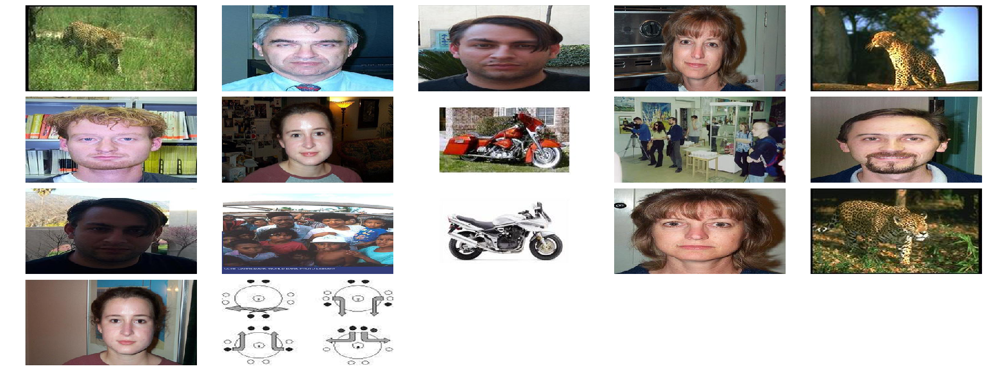

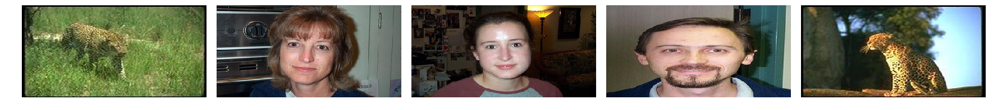

In [15]:
# we will rock you - 1154
# ussain bolt - 582
# 1326, 1409, 1408, 1288, 1406, 1355, 1320, 1413, 1412, 1386, 1375,
#         1344, 1291, 1381, 1437, 1285, 1482, 1477, 1166,  777
# ambassador 754
# BBking, george -> 968, 1881
# kalam - 1010
# fidel - 1279
# Brexit - 1198

random_samples = [1390, 1010, 1188, 645, 1476, 1154, 582, 1801, 184, 1047, 1198, 93, 1953, 1082, 1533, 595, 137]
indices = [0, 3, 6, 9, 4]

plots(random_samples, pd_files, figsize=(26,10), rows=4)

# cherry pick a few for querying
random_samples = np.asarray(random_samples)[indices].tolist()
plots(random_samples, pd_files, figsize=(26,3), rows=1)

### Plot the query results for each image.
We plot the results for each model in a column of its own. The first row indicates the query image and the subsequent rows are nearest neighbors according to various models.

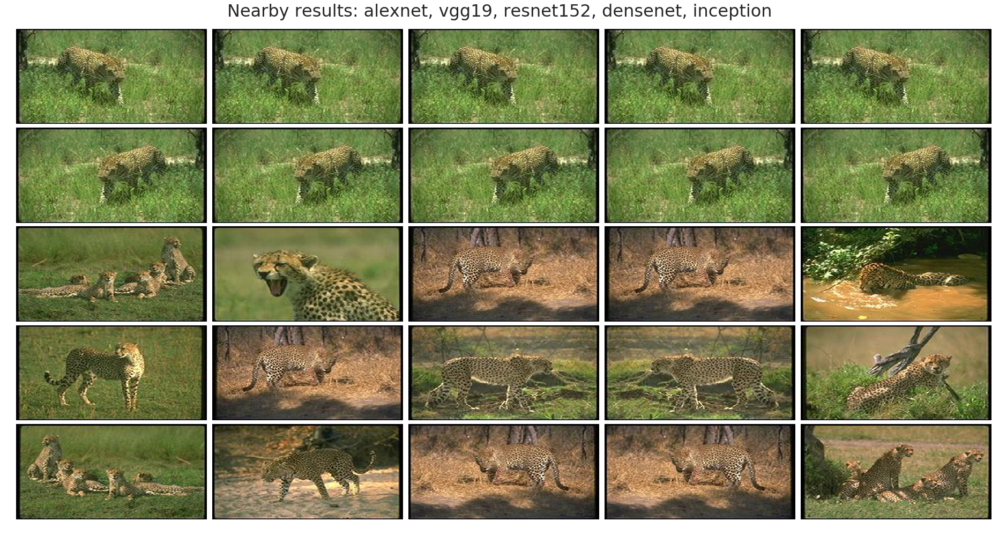

In [16]:
compare_networks(random_samples[0], annoy_indexes, pd_files)

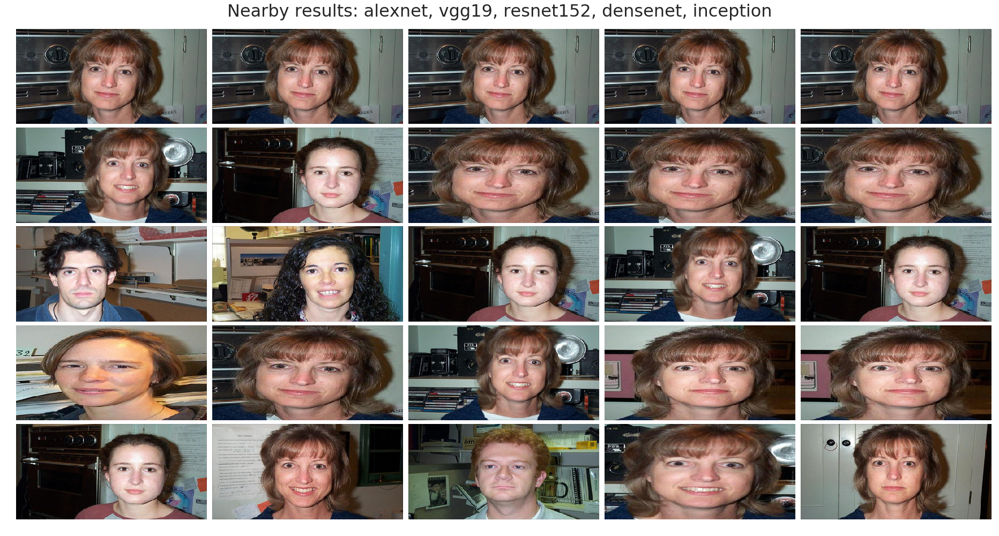

In [17]:
compare_networks(random_samples[1], annoy_indexes, pd_files)

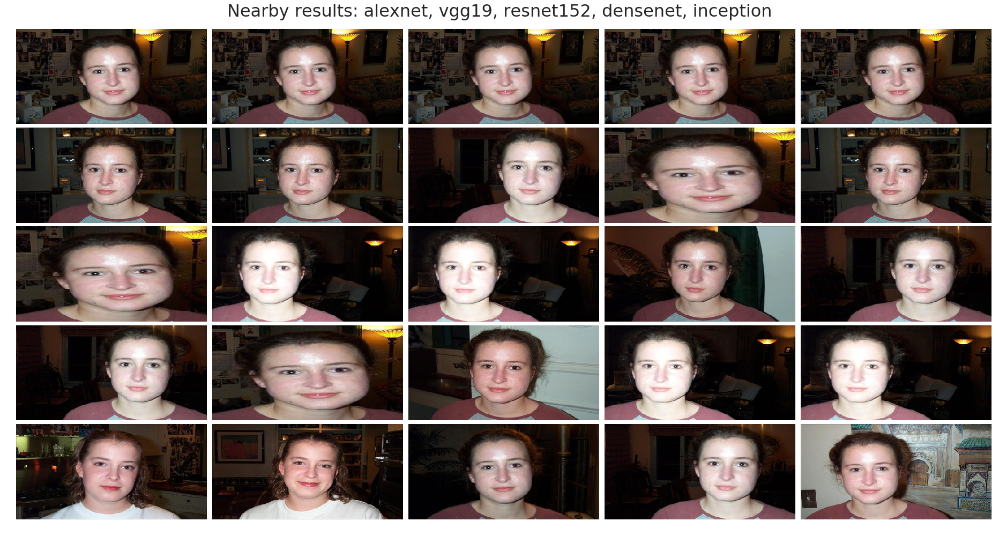

In [18]:
compare_networks(random_samples[2], annoy_indexes, pd_files)

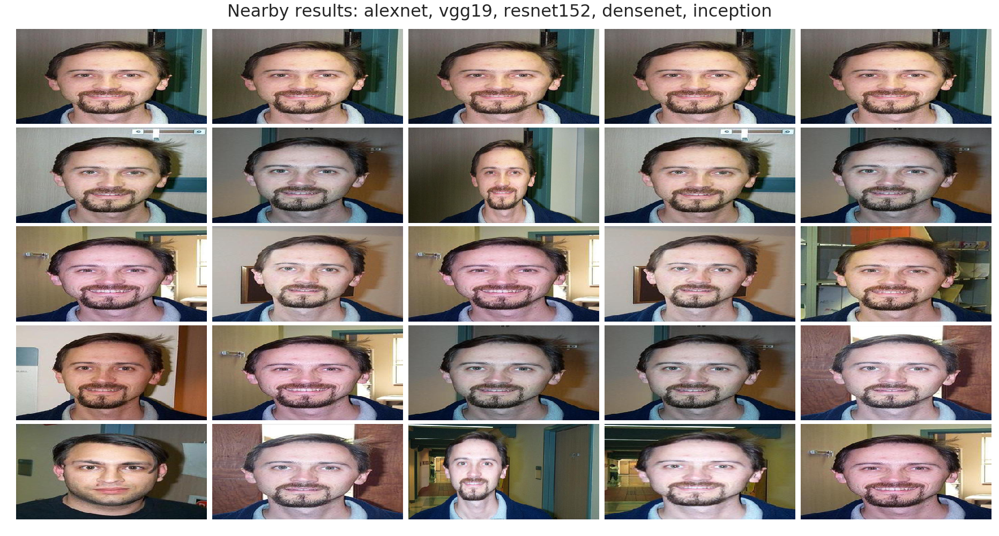

In [19]:
compare_networks(random_samples[3], annoy_indexes, pd_files)

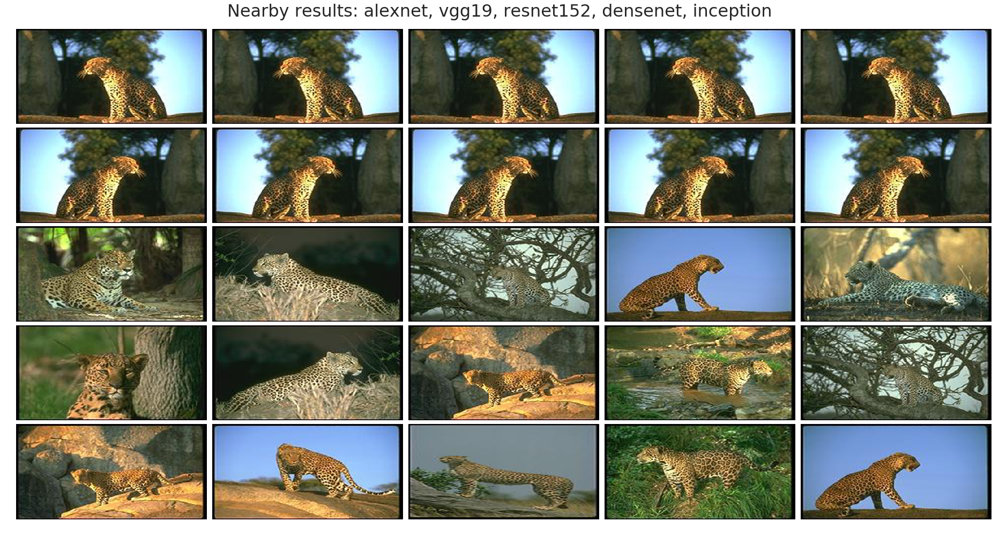

In [20]:
compare_networks(random_samples[4], annoy_indexes, pd_files)

### Ensembling
If one network is not good, let's try to average multiple -- kaggle style! This is not a quick fix solution. As you see below, it works in some cases and it does not in others.

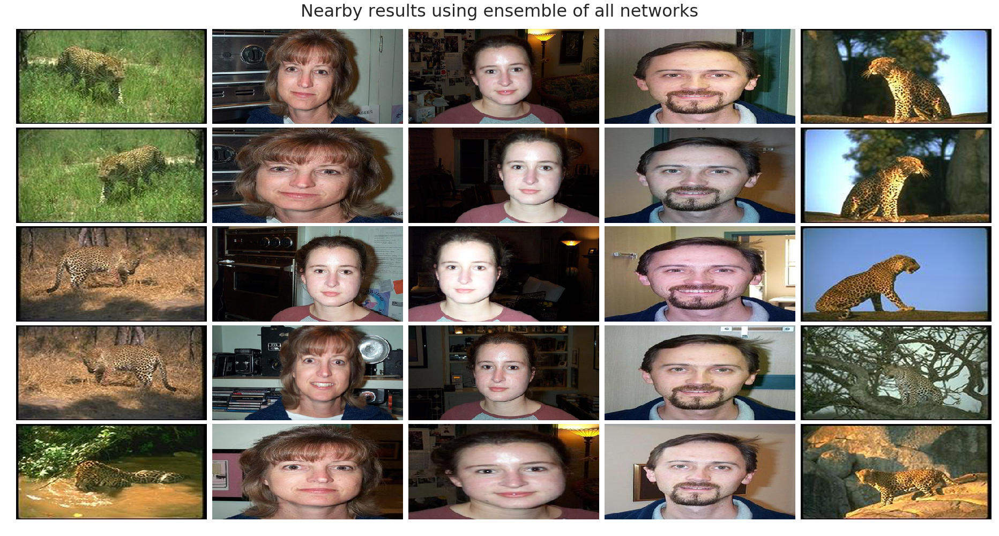

In [21]:
plot_ensemble(random_samples, annoy_indexes, pd_files)

## Image Querying -- Best Ensembling results
In this section, we programmatically find the best images that give the best results for ensembling and cherry pick the aesthetically good ones and use this for querying.

In [0]:
# Just a quick hack to find the most interesting images.
def isGoodforEnsemble(index, annoyIndexes, pd):
    nn_output = [get_similar(index, annoyIndex) for annoyIndex in annoyIndexes ]
    flat_list = np.asarray(nn_output).transpose().reshape(-1).tolist()
    unique, counts = np.unique(flat_list, return_counts=True)

    cnt = collections.Counter()
    for x in flat_list:
        cnt[x] += 1

    items = []
    for item, count in cnt.most_common(25):
        if count > 1:
            items.append(item)
#     print(index, cnt.most_common(6), len(items))
    return len(items)
filtered_samples = [1390, 1010, 1188, 645, 1476, 1154, 582, 1801, 184, 1047, 1198, 93, 1953, 1082, 1533, 595, 137]

result_tuple = [(i,isGoodforEnsemble(i, annoy_indexes, pd_files)) for i in pd_files.index.to_list()]
result_tuple.sort(key=lambda tup:tup[1], reverse=True)
# result_tuple

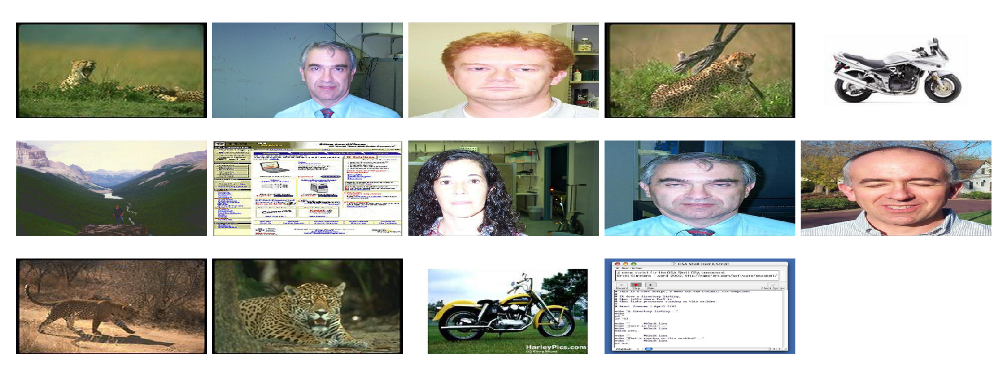

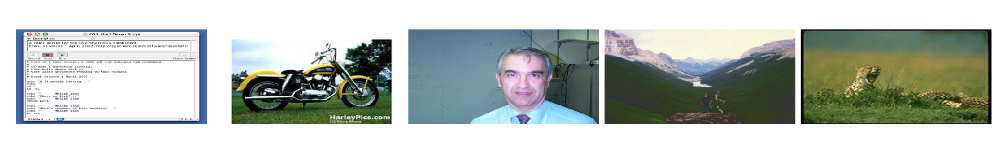

In [23]:
# # Filtered samples for visual interestingness based on ensemble results sampling
filtered_samples = [1446, 557, 923, 1444, 1953, 230, 351, 804, 1010, 1214, 1382, 1520, 1606, 279]
indices = [13, 12, 1, 5, 0]
plots(filtered_samples, pd_files, figsize=(26,10), rows=3)
filtered_samples = np.asarray(filtered_samples)[indices].tolist()
# print(random_samples)
plots(filtered_samples, pd_files, figsize=(26,4), rows=1)

### Plot the query for each Image

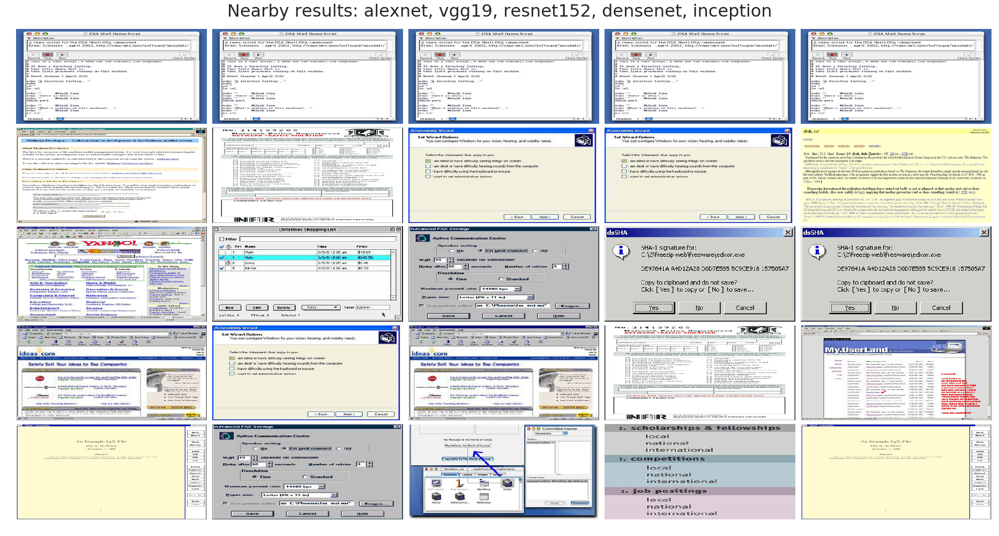

In [24]:
compare_networks(filtered_samples[0], annoy_indexes, pd_files)

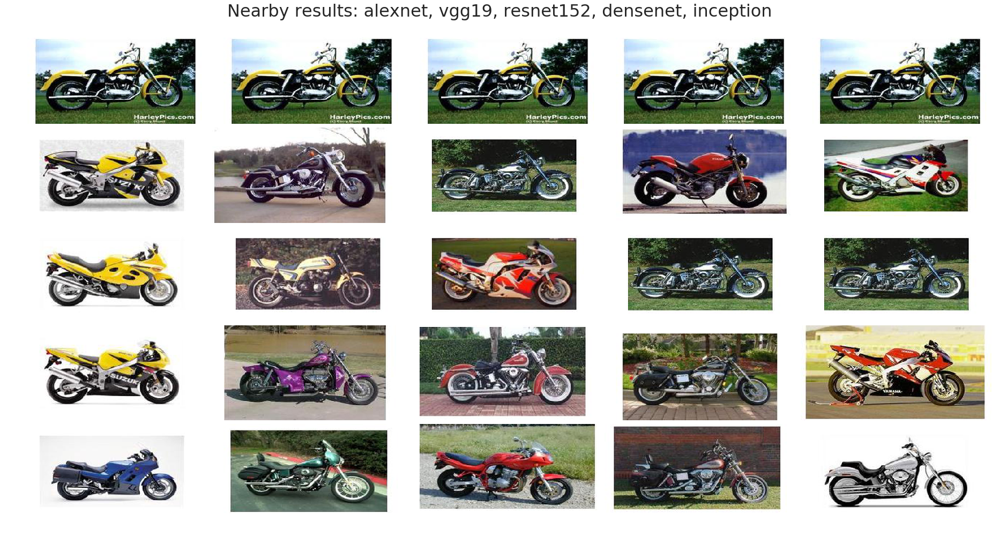

In [25]:
compare_networks(filtered_samples[1], annoy_indexes, pd_files)

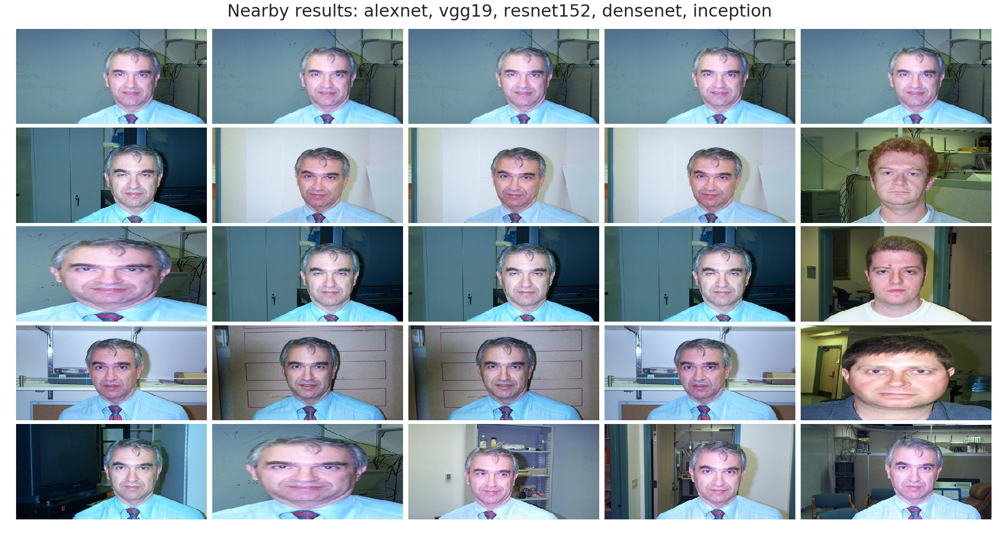

In [26]:
compare_networks(filtered_samples[2], annoy_indexes, pd_files)
# clear progression on query results as you move from left to right!

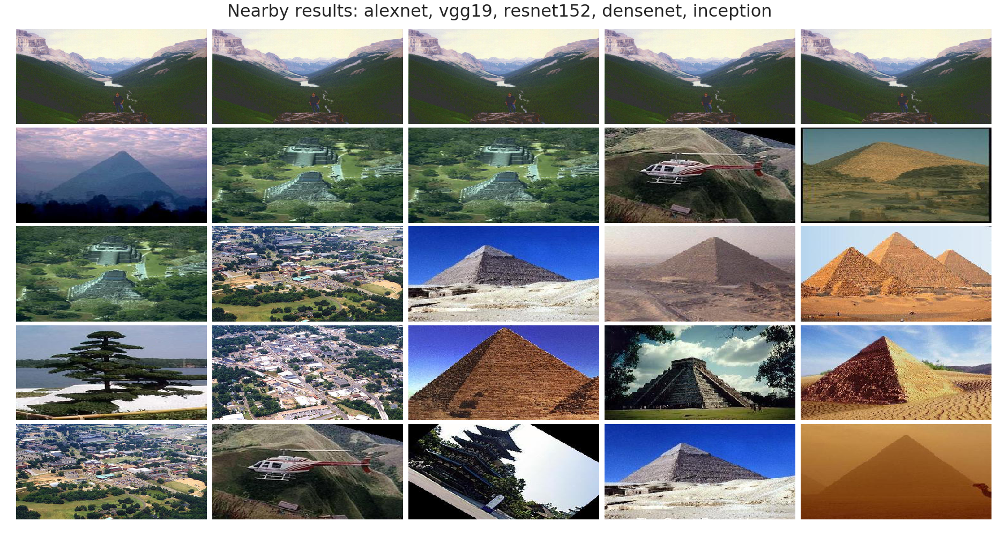

In [27]:
compare_networks(filtered_samples[3], annoy_indexes, pd_files)

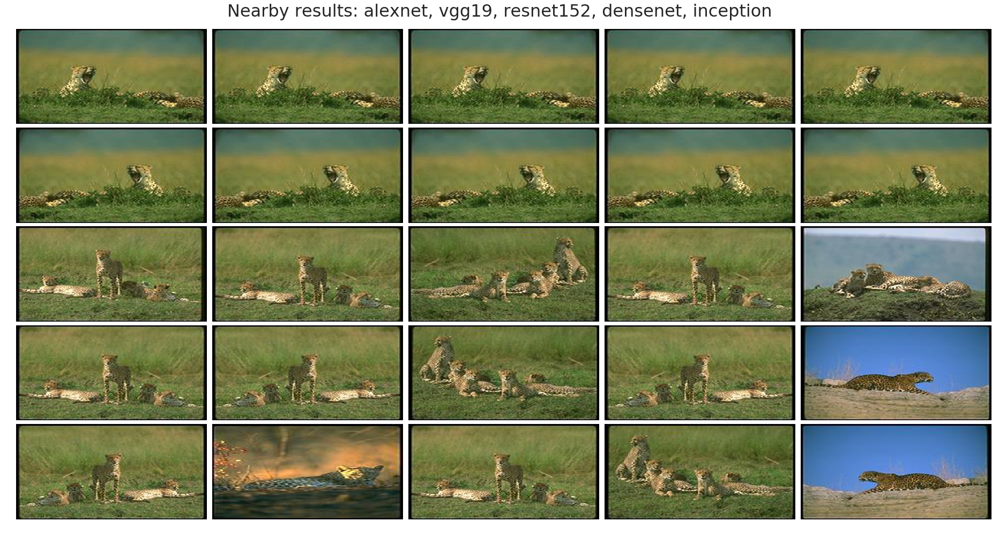

In [28]:
compare_networks(filtered_samples[4], annoy_indexes, pd_files)

### Ensembling results

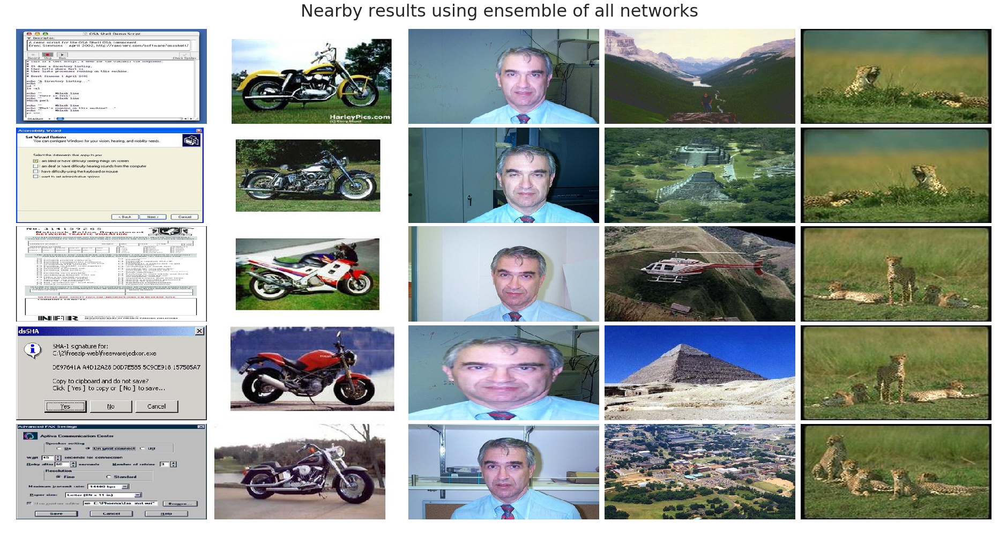

In [29]:
plot_ensemble(filtered_samples, annoy_indexes, pd_files)